In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Recebendo inputs do kaggle e separando em pastas

Importando dependências

In [2]:
# Importe pacotes

import os
import cv2
import numpy as np
import pandas as pd
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import random
import shutil

In [3]:
# Caminhos para as pastas
train_color_dir = "/kaggle/input/train-original"
train_label_dir = "/kaggle/input/train-label"
val_color_dir = "/kaggle/input/val-original"
val_label_dir = "/kaggle/input/val-label"
test_color_dir = "/kaggle/input/test-original"
test_label_dir = "/kaggle/input/test-label"

In [4]:
# Listar imagens (assumindo que os pares têm o mesmo nome de arquivo)
train_color_images = sorted(os.listdir(train_color_dir))
val_color_images = sorted(os.listdir(val_color_dir))
test_color_images = sorted(os.listdir(test_color_dir))

train_label_images = sorted(os.listdir(train_label_dir))
val_label_images = sorted(os.listdir(val_label_dir))
test_label_images = sorted(os.listdir(test_label_dir))

# Extraindo nomes dos arquivos (sem a extensão)
train_names = [os.path.splitext(img)[0] for img in train_color_images]
val_names = [os.path.splitext(img)[0] for img in val_color_images]
test_names = [os.path.splitext(img)[0] for img in test_color_images]

train_names_labels = [os.path.splitext(img)[0] for img in train_label_images]
val_names_labels = [os.path.splitext(img)[0] for img in val_label_images]
test_names_labels = [os.path.splitext(img)[0] for img in test_label_images]




Preparando imagens

In [5]:
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image

# Definindo transformações para as imagens
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Redimensiona as imagens para um tamanho fixo
    transforms.ToTensor()  # Converte as imagens para tensores
])

# Classe customizada para carregar as imagens
class CustomDataset(Dataset):
    def __init__(self, label_dir, color_dir, image_names, label_names, transform=None):
        self.label_dir = label_dir
        self.color_dir = color_dir
        self.image_names = image_names
        self.label_names = label_names
        self.transform = transform

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        label_image_path = os.path.join(self.label_dir, f"{self.label_names[idx]}.png")
        color_image_path = os.path.join(self.color_dir, f"{self.image_names[idx]}.png")

        label_image = Image.open(label_image_path).convert("RGB")
        color_image = Image.open(color_image_path).convert("RGB")

        if self.transform:
            label_image = self.transform(label_image)
            color_image = self.transform(color_image)

        return label_image, color_image

# Criando datasets
train_dataset = CustomDataset(train_label_dir, train_color_dir, train_names, train_names_labels, transform=transform)
val_dataset = CustomDataset(val_label_dir, val_color_dir, val_names, val_names_labels, transform=transform)
test_dataset = CustomDataset(test_label_dir, test_color_dir, test_names, test_names_labels, transform=transform)

# Criando DataLoaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)

print("DataLoaders criados com sucesso!")

DataLoaders criados com sucesso!


Definindo Gerador

In [6]:
# U-Net

import torch
import torch.nn as nn
import torch.nn.functional as F

class UNet(nn.Module):
    def __init__(self, image_dim, n_channels=64, depth=5, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1):
        super(UNet, self).__init__()

        self.image_dim = image_dim  # Dimensões da imagem de entrada (C, H, W)
        self.depth = depth 
        self.n_channels = n_channels
        self.conv_kernel_size = conv_kernel_size
        self.conv_stride = conv_stride
        self.conv_padding = conv_padding
        self.pool_kernel_size = pool_kernel_size
        self.pool_stride = pool_stride
        self.pool_padding = pool_padding
        self.transpose_kernel_size = transpose_kernel_size
        self.transpose_stride = transpose_stride
        self.transpose_padding = transpose_padding

        # Encoder
        self.encoders = nn.ModuleList([self.conv_block(3 if i == 0 else self.n_channels * (2 ** (i-1)), self.n_channels * (2 ** i)) for i in range(self.depth)])
        self.pool = nn.MaxPool2d(kernel_size=self.pool_kernel_size, stride=self.pool_stride, padding=self.pool_padding)

        # Bottleneck
        self.bottleneck = self.conv_block(self.n_channels * (2 ** (self.depth-1)), self.n_channels * (2 ** self.depth))

        # Decoder
        self.decoders = nn.ModuleList([self.conv_transpose(self.n_channels * (2 ** (i+2)), self.n_channels * (2 ** i)) for i in range(self.depth-2, -1, -1)])

        # Final conv layer
        self.final_conv = nn.Conv2d(self.n_channels, 3, kernel_size=1)

    def conv_block(self, in_channels, out_channels):
        # Camada convolucional com normalização e função de ativação; 2 vezes
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),  # Normalização para acelerar o treinamento
            nn.ReLU(inplace=True),  # Função de ativação (zera os valores negativos)
            nn.Conv2d(out_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def crop(self, encoder_feature, decoder_feature):
        _, _, h, w = decoder_feature.size()
        encoder_feature = F.interpolate(encoder_feature, size=(h, w), mode='bilinear', align_corners=False)  # Redimensiona a feature map do encoder
        return encoder_feature

    def conv_transpose(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=self.transpose_kernel_size, stride=self.transpose_stride, padding=self.transpose_padding),
            self.conv_block(out_channels, out_channels)
        )
    
    def forward(self, x):
        #print(f"Input shape: {x.shape}")
        encoders_features = []

        # Encoder pass
        for idx, encoder in enumerate(self.encoders):
            #print("idx: ", idx)
            #print("encoder: ", encoder)
            x = encoder(x)
            encoders_features.append(x)
            #print(f"After encoder block {idx+1}: {x.shape}")
            x = self.pool(x)
            #print(f"After pooling {idx+1}: {x.shape}")

        # Bottleneck
        x = self.bottleneck(x)
        #print(f"After bottleneck: {x.shape}")
        # Doubled the block
        #print("Starting decoder pass")
        # Decoder pass
        for i, decoder in enumerate(self.decoders):
            #print("i: ", i)
            #print("decoder: ", decoder)
            encoder_feature = encoders_features[-(i+1)]
            encoder_feature = self.crop(encoder_feature, x)  # Aplica o crop nas feature maps
            #print(f"Encoder feature {i+1} after crop: {encoder_feature.shape}")

            if i != 0:
                x = torch.cat([encoder_feature, x], dim=1)  # Concatena encoder com decoder
                #print(f"After concatenation with encoder feature {i+1}: {x.shape}")

            x = decoder(x)

        # Final convolution
        x = self.final_conv(x)
        x = F.interpolate(x, size=(self.image_dim[2], self.image_dim[3]), mode='bilinear', align_corners=False)
        #print(f"Output shape after final convolution: {x.shape}")
        
        x = torch.sigmoid(x)
        
        return x

Testando gerador

Gerador gera uma imagem do tamanho desejado, passando pela unet

Discriminador

In [7]:

class Discriminator(nn.Module):
    def __init__(self, image_dim, n_channels=64, depth=5, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1):
        super().__init__()

        self.image_dim = image_dim  # Dimensões da imagem de entrada (C, H, W)
        self.depth = depth 
        self.n_channels = n_channels
        self.conv_kernel_size = conv_kernel_size
        self.conv_stride = conv_stride
        self.conv_padding = conv_padding
        self.pool_kernel_size = pool_kernel_size
        self.pool_stride = pool_stride
        self.pool_padding = pool_padding
        self.transpose_kernel_size = transpose_kernel_size
        self.transpose_stride = transpose_stride
        self.transpose_padding = transpose_padding

        # Encoder
        self.encoders = nn.ModuleList([self.conv_block(3 if i == 0 else self.n_channels * (2 ** (i-1)), self.n_channels * (2 ** i)) for i in range(self.depth)])
        self.pool = nn.MaxPool2d(kernel_size=self.pool_kernel_size, stride=self.pool_stride, padding=self.pool_padding)

        # Bottleneck
        self.bottleneck = self.conv_block(self.n_channels * (2 ** (self.depth-1)), self.n_channels * (2 ** self.depth))

        # Final conv layer
        self.final_conv = nn.Conv2d(self.n_channels * (2 ** self.depth), 1, kernel_size=1)

        # Fully connected layer to reduce the dimensions to [32, 1, 1, 1]
        self.fc = nn.Linear(self.image_dim[2] * self.image_dim[3], 1)

    def conv_block(self, in_channels, out_channels):
        # Camada convolucional com normalização e função de ativação; 2 vezes
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),  # Normalização para acelerar o treinamento
            nn.ReLU(inplace=True)  # Função de ativação (zera os valores negativos)
        )
    
        """
            nn.Conv2d(out_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        """

    def crop(self, encoder_feature, decoder_feature):
        _, _, h, w = decoder_feature.size()
        encoder_feature = F.interpolate(encoder_feature, size=(h, w), mode='bilinear', align_corners=False)  # Redimensiona a feature map do encoder
        return encoder_feature

    def conv_transpose(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=self.transpose_kernel_size, stride=self.transpose_stride, padding=self.transpose_padding),
            self.conv_block(out_channels, out_channels)
        )
    
    def forward(self, x):
        #print(f"Input shape: {x.shape}")
        encoders_features = []

        # Encoder pass
        for idx, encoder in enumerate(self.encoders):
            #print("idx: ", idx)
            #print("encoder: ", encoder)
            x = encoder(x)
            encoders_features.append(x)
            #print(f"After encoder block {idx+1}: {x.shape}")
            x = self.pool(x)
            #print(f"After pooling {idx+1}: {x.shape}")

        # Bottleneck
        x = self.bottleneck(x)
        #print(f"After bottleneck: {x.shape}")
        # Doubled the block
        #print("Starting decoder pass")

        # Final convolution
        x = self.final_conv(x)
        x = F.interpolate(x, size=(1, 1), mode='bilinear', align_corners=False)
        #print(f"Output shape after final convolution: {x.shape}")
        x = torch.sigmoid(x)


        return x

Treino

In [8]:
class LSGANLoss(nn.Module):
    def __init__(self):
        super(LSGANLoss, self).__init__()
        self.criterion = nn.MSELoss()

    def forward(self, yhat_fake, yhat_real):
        # Para o gerador, queremos que as previsões do discriminador (yhat_fake) estejam o mais próximo possível de 1
        g_loss = self.criterion(yhat_fake, torch.ones_like(yhat_fake))
        
        # Para o discriminador, queremos que as previsões em imagens reais estejam próximas de 1
        real_loss = self.criterion(yhat_real, torch.ones_like(yhat_real))
        
        # E para as imagens falsas, as previsões devem ser próximas de 0
        fake_loss = self.criterion(yhat_fake, torch.zeros_like(yhat_fake))
        
        d_loss = (real_loss + fake_loss) / 2
        return g_loss, d_loss

    
def gradient_penalty(discriminator, real_data, fake_data, device):
    alpha = torch.rand(real_data.size(0), 1, 1, 1).to(device)
    interpolates = (alpha * real_data + (1 - alpha) * fake_data).requires_grad_(True)
    d_interpolates = discriminator(interpolates)
    
    gradients = torch.autograd.grad(
        outputs=d_interpolates, inputs=interpolates,
        grad_outputs=torch.ones(d_interpolates.size()).to(device),
        create_graph=True, retain_graph=True, only_inputs=True
    )[0]
    
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty


from torchvision.models import vgg16

class PerceptualLoss(nn.Module):
    def __init__(self, device):
        super(PerceptualLoss, self).__init__()
        #vgg = vgg16(pretrained=True).features[:16]  # Usar as camadas iniciais da VGG
        vgg = vgg16(weights=None).features[:16]
        self.vgg = vgg.eval().to(device)  # Modo de avaliação
        for param in self.vgg.parameters():
            param.requires_grad = False  # Congelar os pesos da VGG
        
        self.criterion = nn.L1Loss()  # Usar L1 Loss para comparar as features

    def forward(self, real_img, fake_img):
        real_features = self.vgg(real_img)
        fake_features = self.vgg(fake_img)
        perceptual_loss = self.criterion(real_features, fake_features)
        return perceptual_loss

    
import torch
import torch.nn as nn
import torchvision.models as models

class StyleLoss(nn.Module):
    def __init__(self, device):
        super(StyleLoss, self).__init__()
        # Carregar a VGG16 pré-treinada até a camada 16
        #vgg = models.vgg16(pretrained=True).features[:16]
        vgg = models.vgg16(weights=None).features[:16]
        self.vgg = vgg.eval().to(device)  # Colocar em modo de avaliação (não treina)
        
        # Congelar os parâmetros da VGG
        for param in self.vgg.parameters():
            param.requires_grad = False
        
        self.criterion = nn.L1Loss()  # Critério para a diferença entre as features

    def gram_matrix(self, features):
        """
        Calcula a matriz de Gram para um conjunto de features
        """
        (b, c, h, w) = features.size()
        features = features.view(b, c, h * w)
        G = torch.bmm(features, features.transpose(1, 2))  # Produto matricial
        return G.div(c * h * w)

    def forward(self, real_img, fake_img):
        # Extrair features usando a VGG
        real_features = self.vgg(real_img)
        fake_features = self.vgg(fake_img)

        # Calcular as matrizes de Gram para as imagens real e gerada
        gram_real = self.gram_matrix(real_features)
        gram_fake = self.gram_matrix(fake_features)

        # Calcular a diferença entre as matrizes de Gram como a perda de estilo
        style_loss = self.criterion(gram_real, gram_fake)
        return style_loss


class TVLoss(nn.Module):
    def forward(self, img):
        batch_size, c, h, w = img.size()
        tv_h = torch.mean((img[:,:,1:,:] - img[:,:,:-1,:])**2)
        tv_w = torch.mean((img[:,:,:,1:] - img[:,:,:,:-1])**2)
        return tv_h + tv_w


In [9]:
from torch.optim import Adam, SGD
from torch.nn import BCELoss, L1Loss, MSELoss
import time

# Loss para o discriminador
d_loss = BCELoss()

class GeneratorLoss(nn.Module):
    def __init__(self, lambda_l1=100):
        super(GeneratorLoss, self).__init__()
        # Definir a perda BCE (usada para a parte adversária)
        self.adversarial_loss = nn.MSELoss()
        # Definir a perda L1
        self.l1_loss = nn.L1Loss()
        # Peso da perda L1
        self.lambda_l1 = lambda_l1

    def forward(self, yhat_fake, fake_images, real_images):
        """
        Parâmetros:
        - yhat_fake: As previsões do discriminador sobre as imagens geradas (fake)
        - fake_images: Imagens geradas pelo gerador
        - real_images: Imagens reais de referência
        
        Retorna:
        - A perda total combinando perda adversária e L1
        """
        # Perda adversária: tentar fazer o discriminador acreditar que as imagens geradas são reais
        adversarial_loss = self.adversarial_loss(yhat_fake, torch.ones_like(yhat_fake))
        
        # Perda L1: minimizar a diferença entre as imagens geradas e as reais
        l1_loss = self.l1_loss(fake_images, real_images)
        
        # Perda total: adversária + ponderação da perda L1
        total_loss = adversarial_loss + self.lambda_l1 * l1_loss
        
        return total_loss
    
class ImprovedGeneratorLoss(nn.Module):
    def __init__(self, device, lambda_l1=100, lambda_perceptual=10, lambda_style=10, lambda_tv=1):
        super(ImprovedGeneratorLoss, self).__init__()
        self.adversarial_loss = MSELoss()
        self.l1_loss = nn.L1Loss()
        self.perceptual_loss = PerceptualLoss(device)
        self.style_loss = StyleLoss(device)
        self.tv_loss = TVLoss()
        self.lambda_l1 = lambda_l1
        self.lambda_perceptual = lambda_perceptual
        self.lambda_style = lambda_style
        self.lambda_tv = lambda_tv

    def forward(self, yhat_fake, fake_images, real_images):
        # Adversarial loss
        g_loss = self.adversarial_loss(yhat_fake, torch.ones_like(yhat_fake))

        # L1 loss
        l1_loss = self.l1_loss(fake_images, real_images)

        # Style loss
        style_loss = self.style_loss(real_images, fake_images)

        # Total variation loss
        tv_loss = self.tv_loss(fake_images)

        # Loss total ponderada
        total_loss = (g_loss + 
                      self.lambda_l1 * l1_loss + 
                      self.lambda_style * style_loss + 
                      self.lambda_tv * tv_loss)
        return total_loss

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
g_loss = ImprovedGeneratorLoss(device)
#g_loss = CycleGANLoss()

# Normalize the input values to be between 0 and 1
def normalize(tensor):
    return (tensor - tensor.min()) / (tensor.max() - tensor.min())


In [10]:
class PaisagemGAN(nn.Module):
    def __init__(self, generator, discriminator):
        super(PaisagemGAN, self).__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.global_step = 0

    def compile(self, g_loss, d_loss):
        self.g_loss = g_loss
        self.d_loss = d_loss
        self.g_opt = Adam(self.generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
        self.d_opt = SGD(self.discriminator.parameters(), lr=0.0002, momentum=0.0)

    def train_step(self, real_images, grey_images):
        
        # Train the discriminator
        #inicio = time.time()
        self.d_opt.zero_grad()
        
        fake_images = self.generator(grey_images)
        yhat_real = self.discriminator(real_images)
        yhat_fake = self.discriminator(fake_images)
        
        # Suavização de rótulos para imagens reais (usando 0.9 ao invés de 1.0)
        d_loss_real = self.d_loss(yhat_real, torch.full_like(yhat_real, 0.9))
        # Suavização opcional de rótulos para imagens falsas (usando 0.1 ao invés de 0.0)
        d_loss_fake = self.d_loss(yhat_fake, torch.full_like(yhat_fake, 0.1))
        # Soma das perdas
        total_d_loss = d_loss_real + d_loss_fake
        total_d_loss.backward()
        
        # Update discriminator weights every 5 steps
        if self.global_step % 5 == 0:
            self.d_opt.step()
        
        self.global_step += 1
        #fim = time.time()
        #print(fim - inicio)

        # Train the generator
        #inicio = time.time()
        self.g_opt.zero_grad()
        
        fake_images = self.generator(grey_images)
        yhat_fake = self.discriminator(fake_images)
        total_g_loss = self.g_loss(yhat_fake, fake_images, real_images)
        
        total_g_loss.backward()
        self.g_opt.step()
        #fim = time.time()
        #print(fim - inicio)
        
        return {'d_loss': total_d_loss.item(), 'g_loss': total_g_loss.item(), 'gen': fake_images}

Realizar treinamento

In [11]:
nex = next(iter(train_loader))
img_dim = nex[0].shape
print(img_dim)

gene = UNet(image_dim=img_dim, n_channels=64, depth=5, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1)
# Configurando o dispositivo (GPU, se disponível)
#device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Dispositivo: {device}")
gene = gene.to(device)  # Mover o modelo para o dispositivo

disc = Discriminator(image_dim=img_dim, n_channels=64, depth=3, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1)
# Configurando o dispositivo (GPU, se disponível)
#device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Dispositivo: {device}")
disc = disc.to(device)  # Mover o modelo para o dispositivo

torch.Size([16, 3, 256, 256])
Dispositivo: cuda
Dispositivo: cuda


In [12]:
def save_checkpoint(model, optimizer, epoch, batch, loss, filepath='checkpoint.pth'):
    checkpoint = {
        'epoch': epoch,
        'batch': batch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss
    }
    torch.save(checkpoint, filepath)

Iniciar treinamento
Epoch [1/100], d_loss: 1.6913, g_loss: 13.8310, val_loss: 14.4218
52.09595537185669


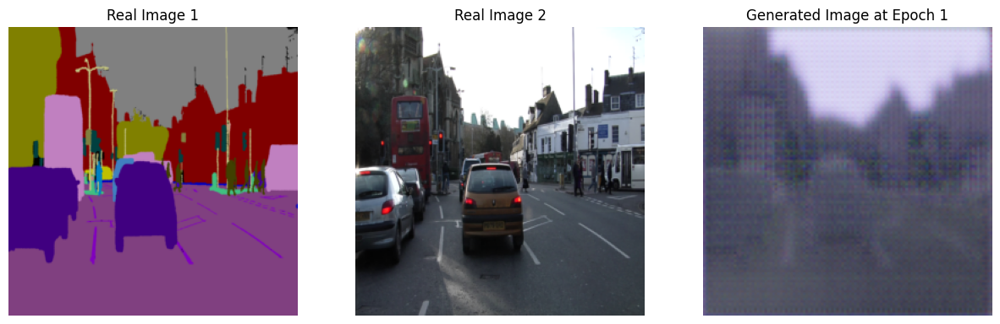

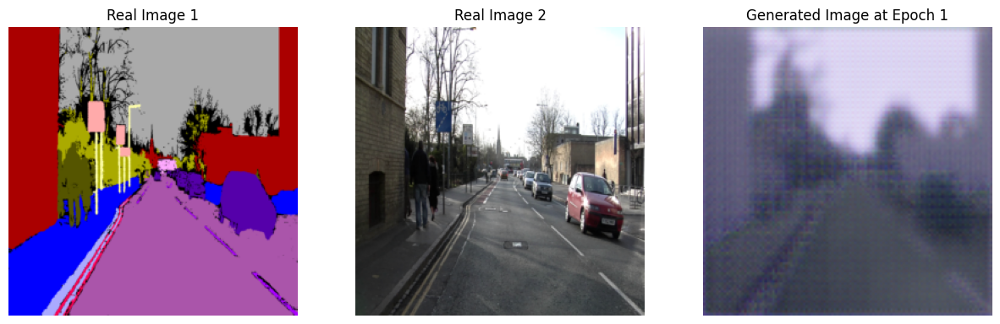

Epoch [2/100], d_loss: 1.7737, g_loss: 16.7747, val_loss: 13.8828
44.80139493942261
Epoch [3/100], d_loss: 1.7198, g_loss: 22.3897, val_loss: 12.9278
43.830073833465576
Epoch [4/100], d_loss: 1.8433, g_loss: 17.1728, val_loss: 14.7037
44.41391086578369
Epoch [5/100], d_loss: 1.7458, g_loss: 10.2544, val_loss: 13.0027
44.31702446937561


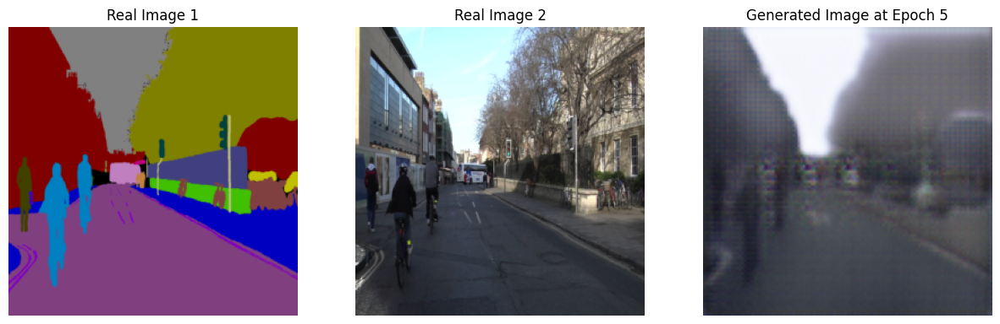

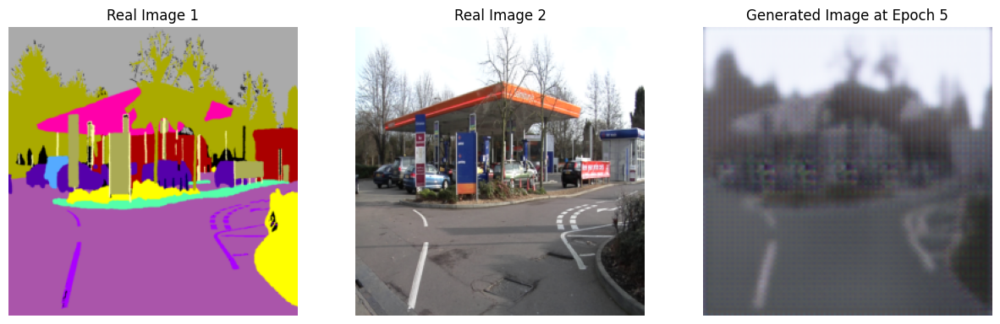

Epoch [6/100], d_loss: 2.0395, g_loss: 17.9236, val_loss: 15.8324
44.55286240577698
Epoch [7/100], d_loss: 2.0093, g_loss: 10.2208, val_loss: 11.9981
44.31924343109131
Epoch [8/100], d_loss: 1.9621, g_loss: 9.5844, val_loss: 13.1874
44.50634503364563
Epoch [9/100], d_loss: 1.4276, g_loss: 23.8331, val_loss: 11.9652
44.208178758621216
Epoch [10/100], d_loss: 1.8155, g_loss: 14.4597, val_loss: 11.5333
44.33003759384155


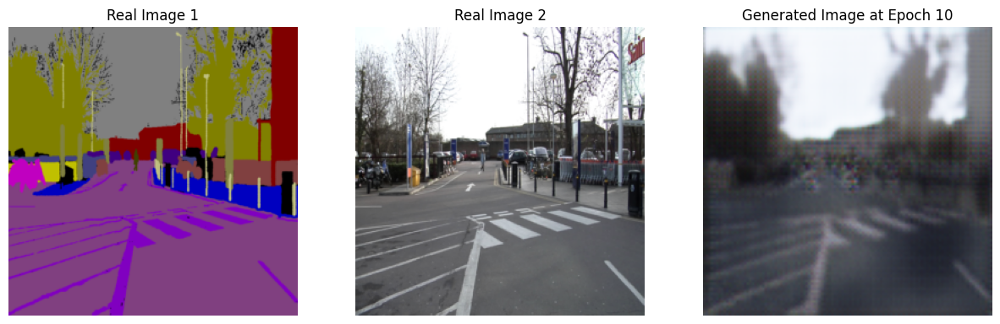

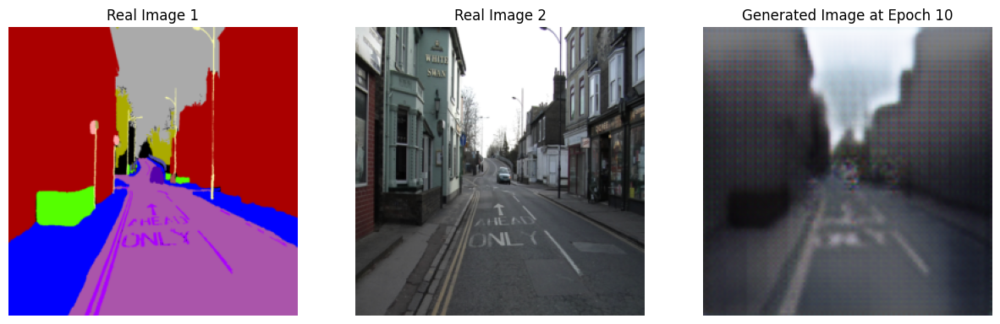

Epoch [11/100], d_loss: 1.4941, g_loss: 14.5376, val_loss: 11.6494
44.51200294494629
Epoch [12/100], d_loss: 1.7819, g_loss: 19.4514, val_loss: 11.9485
44.50898289680481
Epoch [13/100], d_loss: 1.8282, g_loss: 10.9176, val_loss: 11.8769
44.85179162025452
Epoch [14/100], d_loss: 1.5834, g_loss: 12.4226, val_loss: 11.3666
44.85347819328308
Epoch [15/100], d_loss: 2.0441, g_loss: 16.0032, val_loss: 12.7484
44.90125632286072


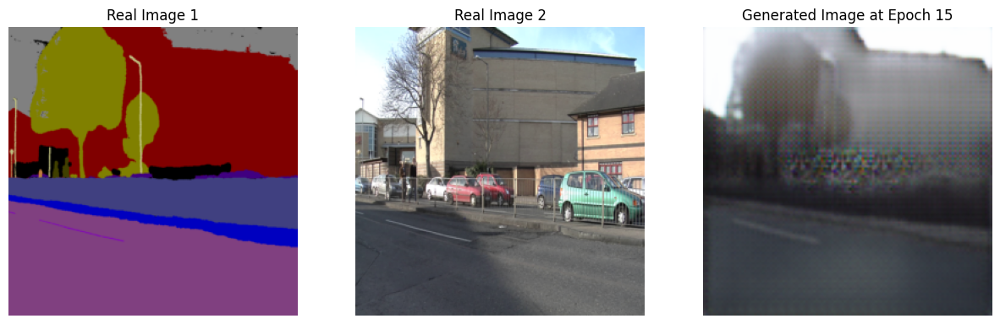

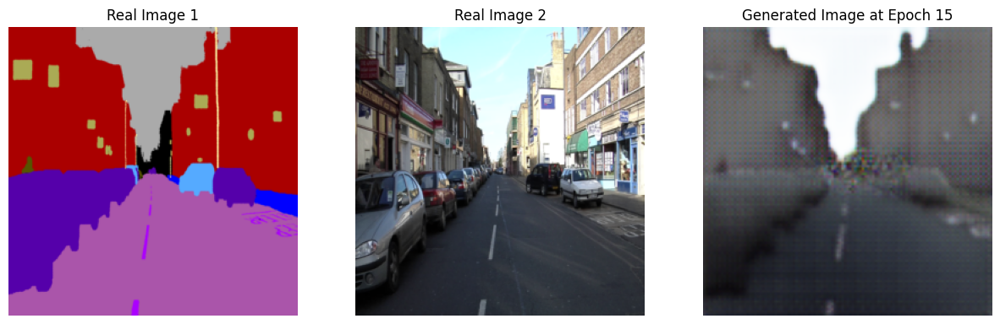

Epoch [16/100], d_loss: 2.3060, g_loss: 8.8367, val_loss: 10.4020
45.20245909690857
Epoch [17/100], d_loss: 2.4471, g_loss: 11.6938, val_loss: 11.0126
44.74902367591858
Epoch [18/100], d_loss: 1.9298, g_loss: 11.1260, val_loss: 11.2202
44.74329948425293
Epoch [19/100], d_loss: 2.1048, g_loss: 11.8622, val_loss: 12.0594
43.91869068145752
Epoch [20/100], d_loss: 1.8465, g_loss: 16.8950, val_loss: 10.7615
44.419660568237305


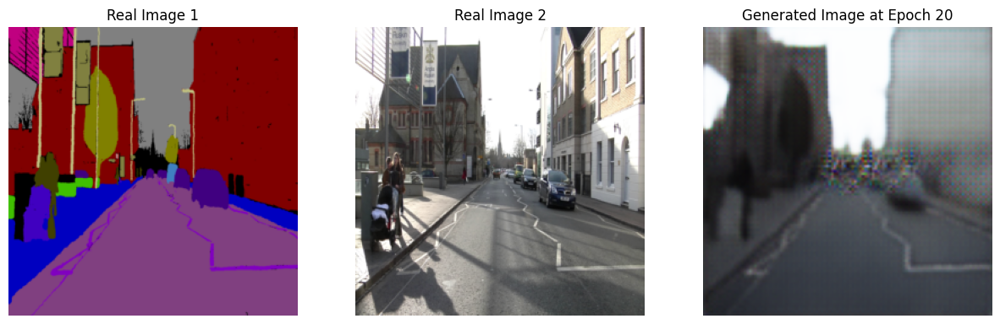

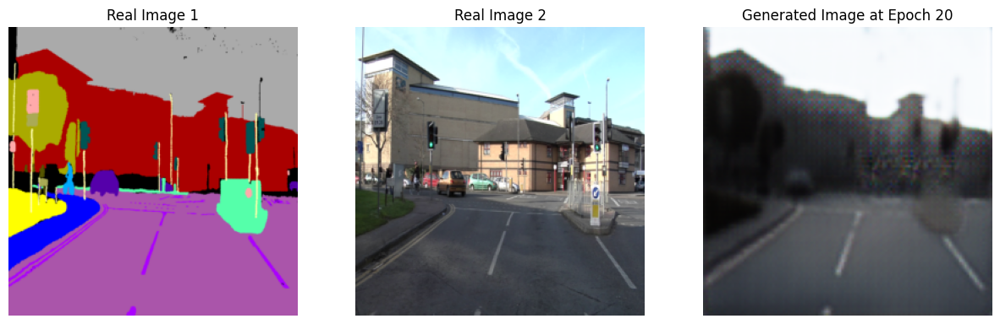

Epoch [21/100], d_loss: 2.0451, g_loss: 10.2568, val_loss: 9.7594
44.203866720199585
Epoch [22/100], d_loss: 2.0249, g_loss: 13.8301, val_loss: 10.4020
44.471435546875
Epoch [23/100], d_loss: 1.5350, g_loss: 11.7689, val_loss: 10.5493
43.70346975326538
Epoch [24/100], d_loss: 2.0992, g_loss: 10.8759, val_loss: 11.2839
44.35726809501648
Epoch [25/100], d_loss: 2.0181, g_loss: 10.1190, val_loss: 9.7647
44.51447772979736


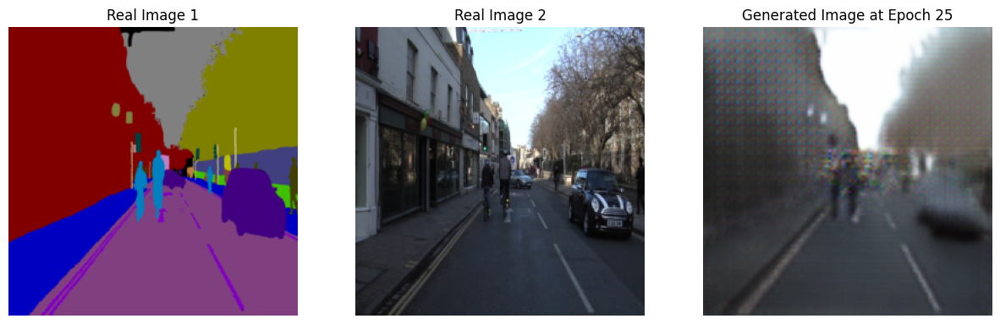

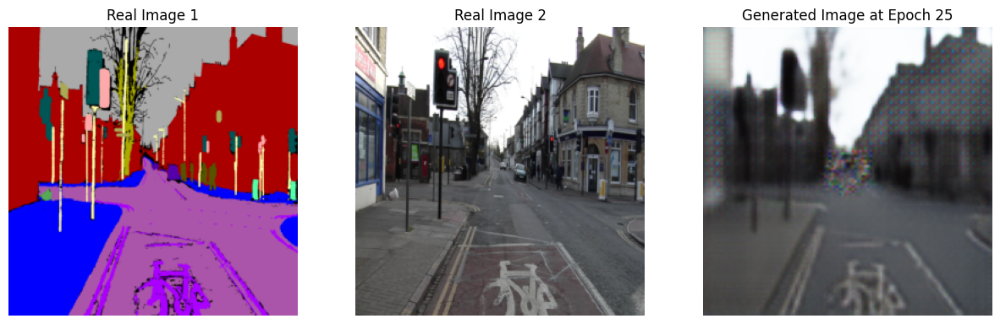

Epoch [26/100], d_loss: 1.9452, g_loss: 10.6381, val_loss: 11.8682
44.75662660598755
Epoch [27/100], d_loss: 1.5734, g_loss: 8.2133, val_loss: 9.6755
44.68509483337402
Epoch [28/100], d_loss: 1.9497, g_loss: 13.3923, val_loss: 9.6088
44.782487869262695
Epoch [29/100], d_loss: 1.6687, g_loss: 8.9344, val_loss: 10.4786
43.916446924209595
Epoch [30/100], d_loss: 1.4630, g_loss: 16.0844, val_loss: 10.7026
43.83842325210571


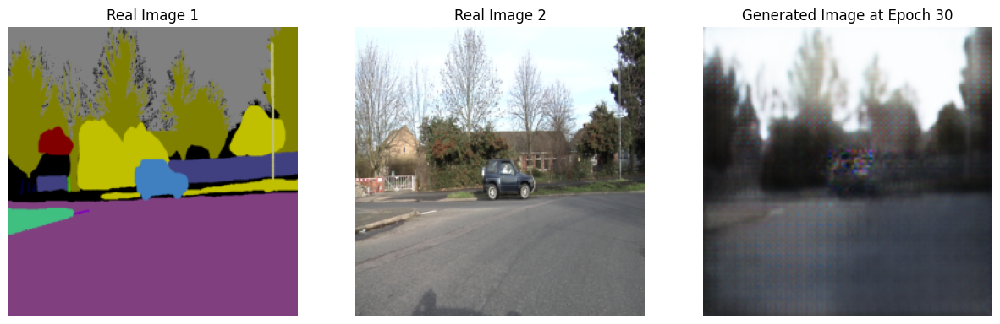

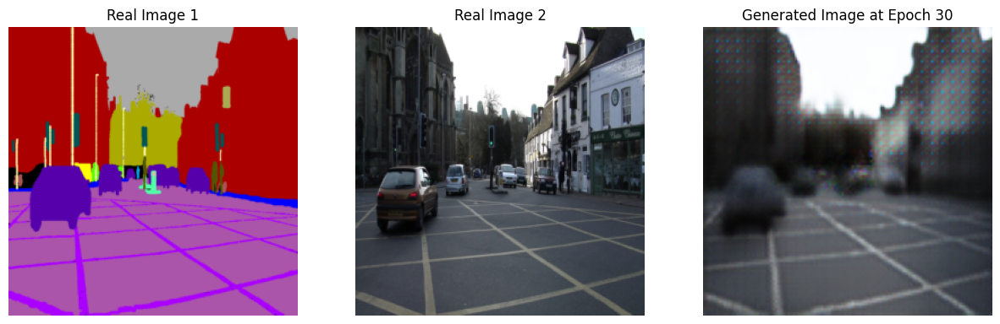

Epoch [31/100], d_loss: 1.5516, g_loss: 17.5002, val_loss: 11.5993
43.8501410484314
Epoch [32/100], d_loss: 1.2417, g_loss: 16.8783, val_loss: 11.7840
44.266878843307495
Epoch [33/100], d_loss: 1.7117, g_loss: 8.0858, val_loss: 10.6576
43.781022787094116
Epoch [34/100], d_loss: 1.6738, g_loss: 5.8883, val_loss: 9.3201
44.51070427894592
Epoch [35/100], d_loss: 1.7740, g_loss: 10.9365, val_loss: 10.0254
43.962015867233276


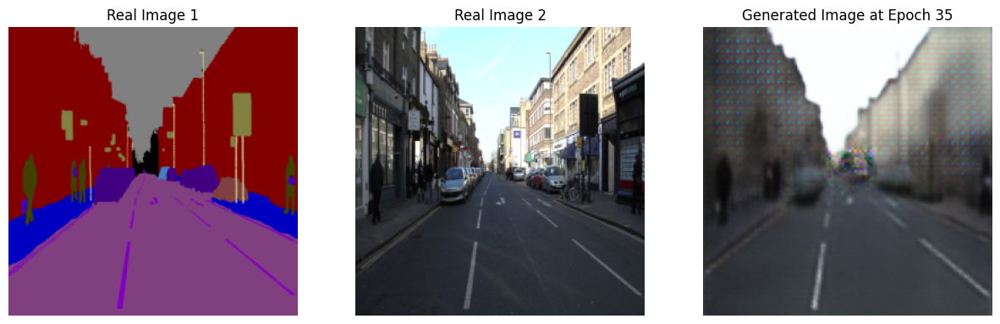

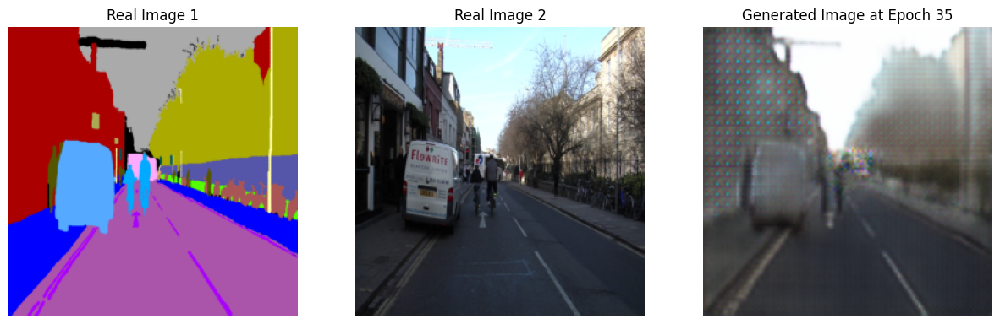

Epoch [36/100], d_loss: 1.5692, g_loss: 8.4954, val_loss: 10.1393
44.080427169799805
Epoch [37/100], d_loss: 1.9752, g_loss: 7.9614, val_loss: 9.7340
44.28175973892212
Epoch [38/100], d_loss: 1.7415, g_loss: 10.8890, val_loss: 11.6775
44.18533802032471
Epoch [39/100], d_loss: 1.7322, g_loss: 8.6754, val_loss: 9.4786
45.26948142051697
Epoch [40/100], d_loss: 1.8410, g_loss: 6.6798, val_loss: 9.2105
45.0131094455719


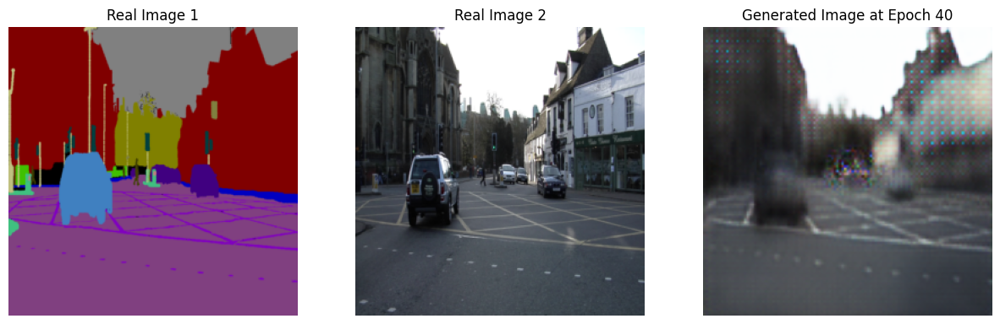

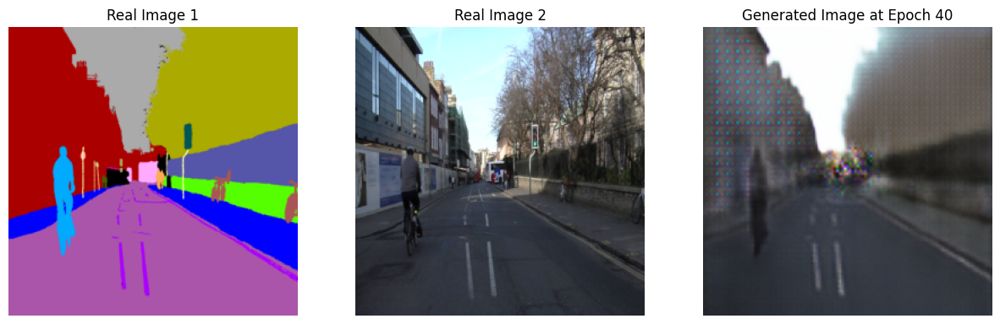

Epoch [41/100], d_loss: 1.2588, g_loss: 16.6340, val_loss: 9.0152
44.904677391052246
Epoch [42/100], d_loss: 1.4042, g_loss: 8.1718, val_loss: 10.9731
44.08092641830444
Epoch [43/100], d_loss: 1.5824, g_loss: 16.3423, val_loss: 8.7646
43.97280716896057
Epoch [44/100], d_loss: 1.8085, g_loss: 8.6846, val_loss: 8.8435
44.82873058319092
Epoch [45/100], d_loss: 1.4660, g_loss: 14.7529, val_loss: 9.1239
44.07442092895508


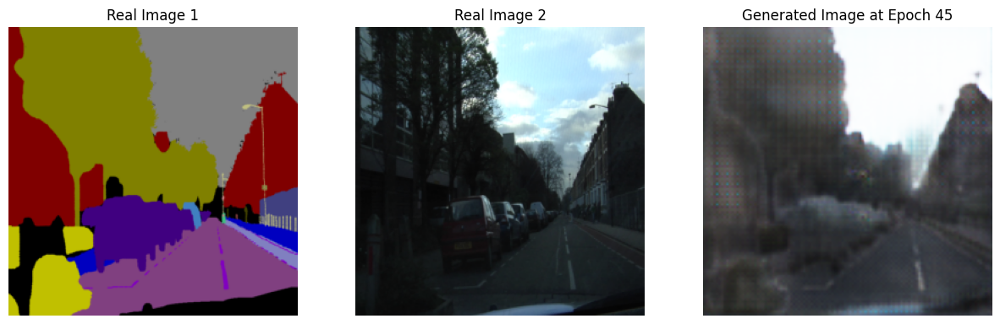

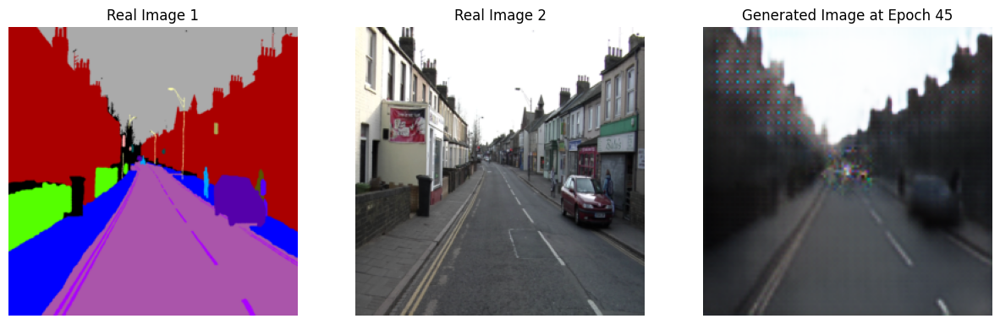

Epoch [46/100], d_loss: 1.6108, g_loss: 9.8695, val_loss: 8.9747
44.89480447769165
Epoch [47/100], d_loss: 1.5740, g_loss: 13.7558, val_loss: 10.1008
44.95408654212952
Epoch [48/100], d_loss: 1.6516, g_loss: 7.6371, val_loss: 10.5379
44.4889702796936
Epoch [49/100], d_loss: 1.5560, g_loss: 8.6190, val_loss: 9.3782
45.133164405822754
Epoch [50/100], d_loss: 1.6832, g_loss: 15.7373, val_loss: 10.9669
45.149189949035645


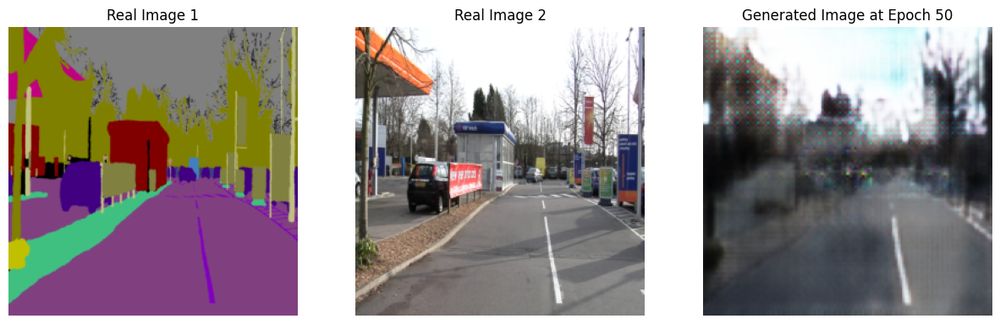

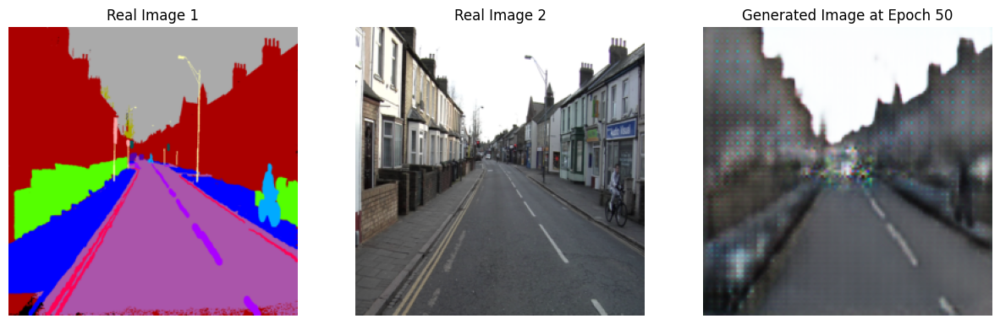

Epoch [51/100], d_loss: 1.4598, g_loss: 8.4622, val_loss: 9.3450
45.412622690200806
Epoch [52/100], d_loss: 1.2413, g_loss: 18.0928, val_loss: 10.9024
44.782169342041016
Epoch [53/100], d_loss: 1.4395, g_loss: 12.6452, val_loss: 9.9511
44.892155170440674
Epoch [54/100], d_loss: 1.4218, g_loss: 10.0981, val_loss: 10.0152
43.99188804626465
Epoch [55/100], d_loss: 1.6556, g_loss: 12.8712, val_loss: 9.3404
43.5343279838562


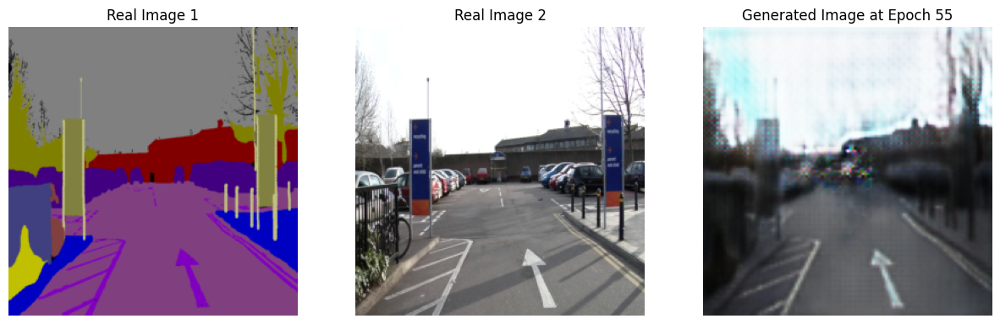

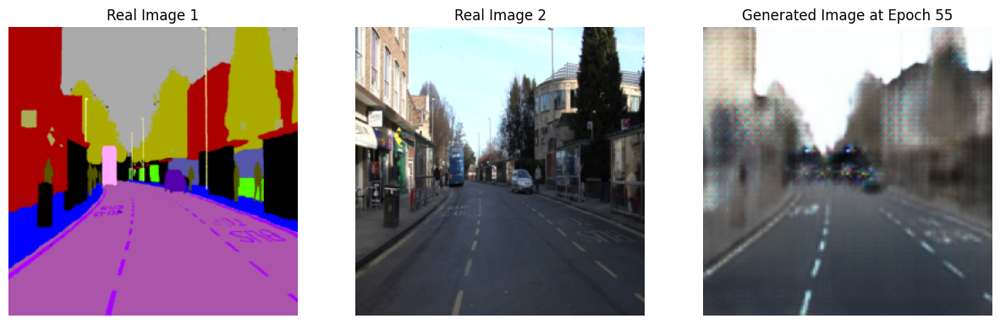

Epoch [56/100], d_loss: 1.7701, g_loss: 6.7376, val_loss: 10.6352
43.40123891830444
Epoch [57/100], d_loss: 1.6744, g_loss: 7.3212, val_loss: 8.8210
43.642244815826416
Epoch [58/100], d_loss: 1.5669, g_loss: 7.0987, val_loss: 9.5221
43.94494843482971
Epoch [59/100], d_loss: 1.9081, g_loss: 9.3764, val_loss: 9.2780
43.45811986923218
Epoch [60/100], d_loss: 1.6002, g_loss: 11.1730, val_loss: 9.2690
44.10983633995056


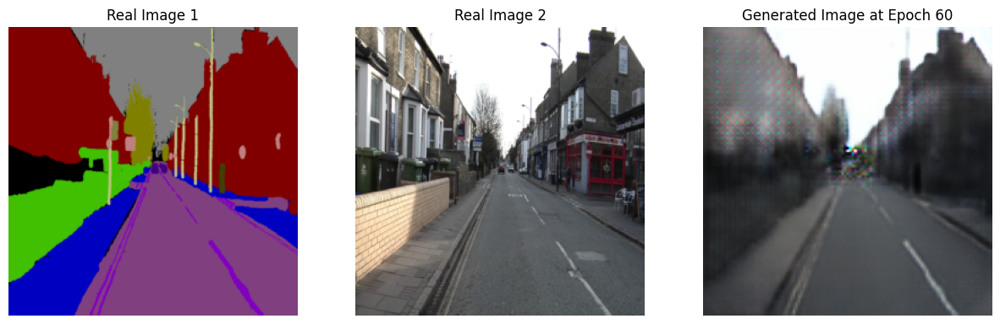

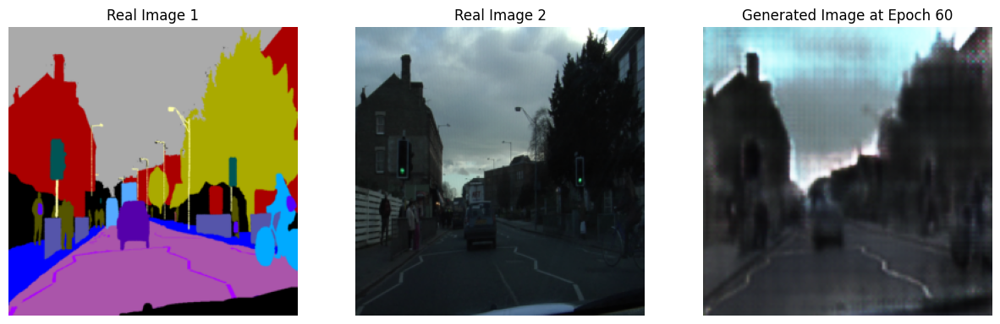

Epoch [61/100], d_loss: 1.8486, g_loss: 9.9352, val_loss: 11.0272
44.15605568885803
Epoch [62/100], d_loss: 1.4782, g_loss: 18.6755, val_loss: 12.2043
43.77028012275696
Epoch [63/100], d_loss: 1.2400, g_loss: 8.0371, val_loss: 11.7228
43.903578996658325
Epoch [64/100], d_loss: 1.4222, g_loss: 7.3064, val_loss: 8.8225
43.76160430908203
Epoch [65/100], d_loss: 1.4015, g_loss: 9.3607, val_loss: 9.5847
43.94150710105896


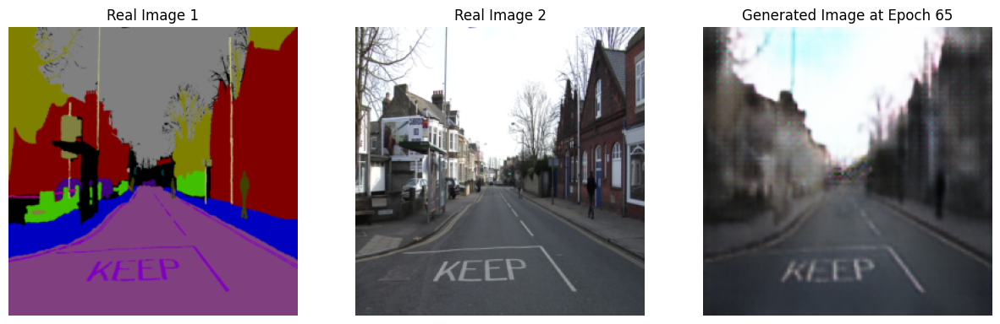

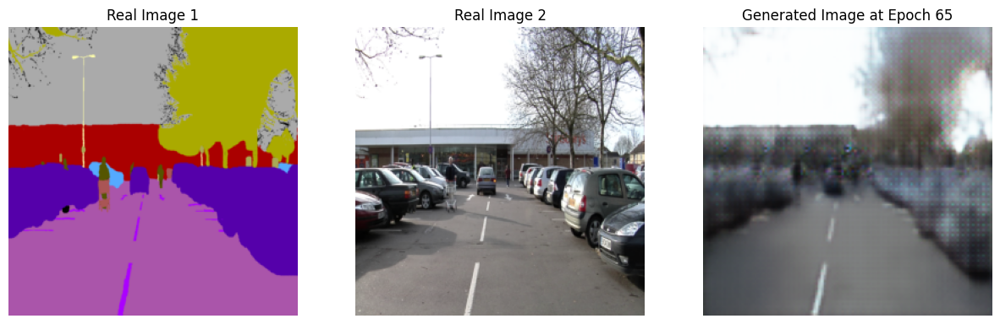

Epoch [66/100], d_loss: 1.1794, g_loss: 7.2556, val_loss: 9.0706
43.57462763786316
Epoch [67/100], d_loss: 2.0652, g_loss: 11.2174, val_loss: 9.7724
43.78800821304321
Epoch [68/100], d_loss: 1.9878, g_loss: 8.9696, val_loss: 9.5099
44.37269997596741
Epoch [69/100], d_loss: 1.4077, g_loss: 6.6483, val_loss: 8.6134
44.6507933139801
Epoch [70/100], d_loss: 2.1168, g_loss: 9.9401, val_loss: 9.7722
44.38175368309021


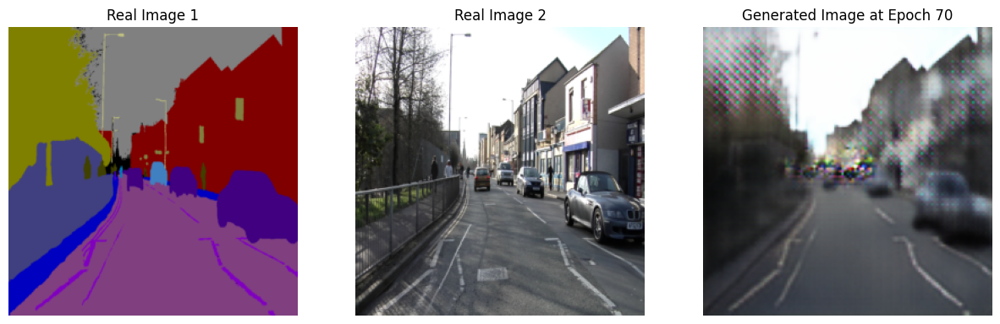

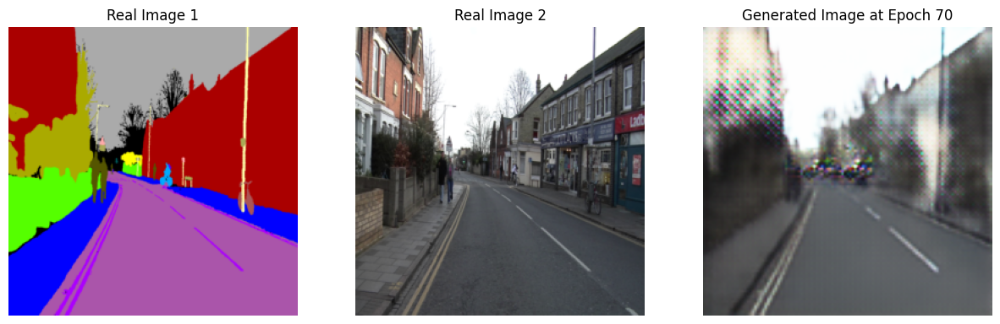

Epoch [71/100], d_loss: 1.4486, g_loss: 9.4244, val_loss: 10.7540
44.328842878341675
Epoch [72/100], d_loss: 1.4128, g_loss: 6.5150, val_loss: 9.0525
44.21530795097351
Epoch [73/100], d_loss: 1.4396, g_loss: 6.2897, val_loss: 8.9588
44.37460398674011
Epoch [74/100], d_loss: 1.3480, g_loss: 6.9564, val_loss: 8.5577
44.35829401016235
Epoch [75/100], d_loss: 1.2716, g_loss: 7.0402, val_loss: 9.3080
44.72510266304016


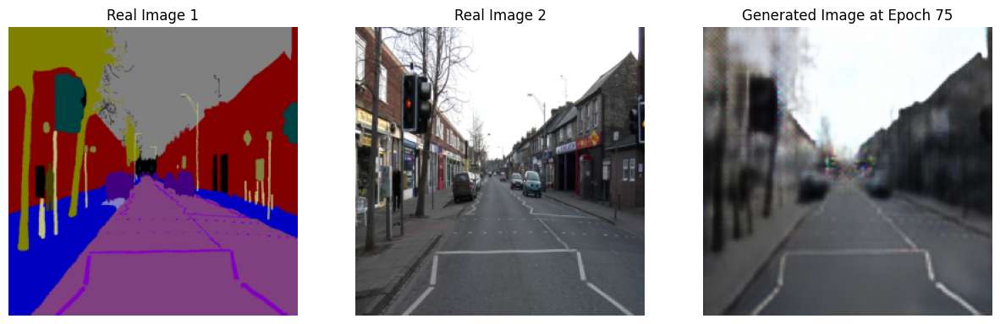

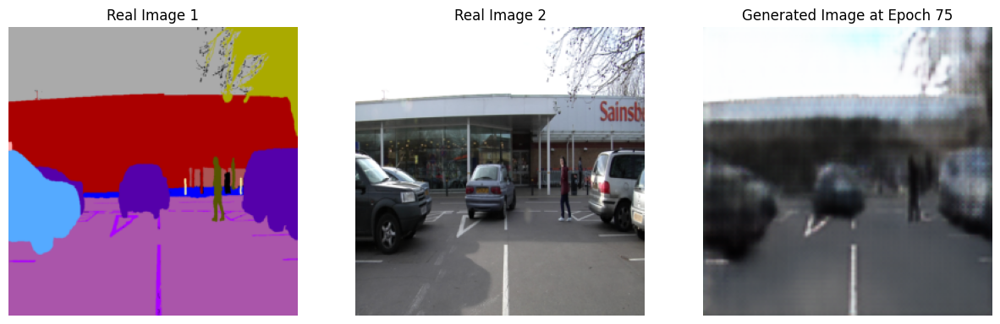

Epoch [76/100], d_loss: 1.5453, g_loss: 5.8713, val_loss: 8.4976
45.39292860031128
Epoch [77/100], d_loss: 1.3541, g_loss: 11.0563, val_loss: 9.0129
45.42464804649353
Epoch [78/100], d_loss: 1.2522, g_loss: 7.0270, val_loss: 8.4400
44.94874811172485
Epoch [79/100], d_loss: 1.6940, g_loss: 8.0749, val_loss: 10.0955
44.37276315689087
Epoch [80/100], d_loss: 1.2508, g_loss: 8.3150, val_loss: 9.1060
44.75743103027344


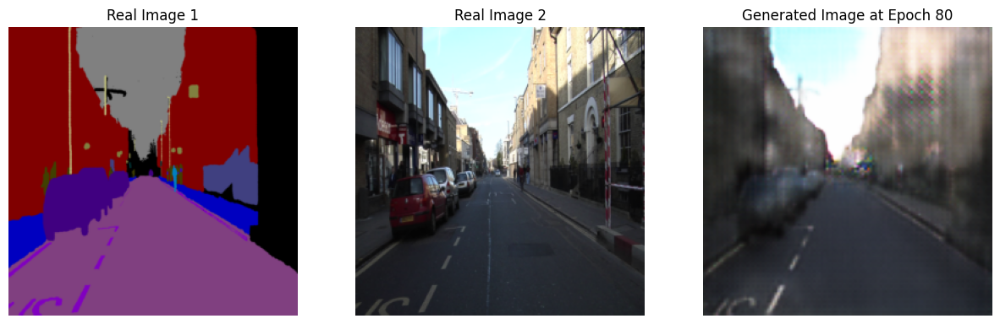

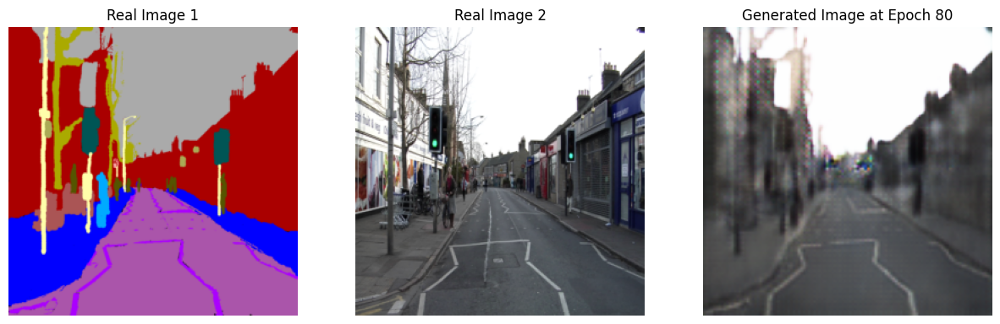

Epoch [81/100], d_loss: 1.9949, g_loss: 9.9932, val_loss: 10.1538
45.0770742893219
Epoch [82/100], d_loss: 1.7162, g_loss: 10.1970, val_loss: 10.8271
44.5891010761261
Epoch [83/100], d_loss: 1.7678, g_loss: 7.9089, val_loss: 9.6156
44.35726976394653
Epoch [84/100], d_loss: 1.4871, g_loss: 6.3022, val_loss: 8.7328
44.38195300102234
Epoch [85/100], d_loss: 1.4798, g_loss: 5.4780, val_loss: 8.8900
44.319995403289795


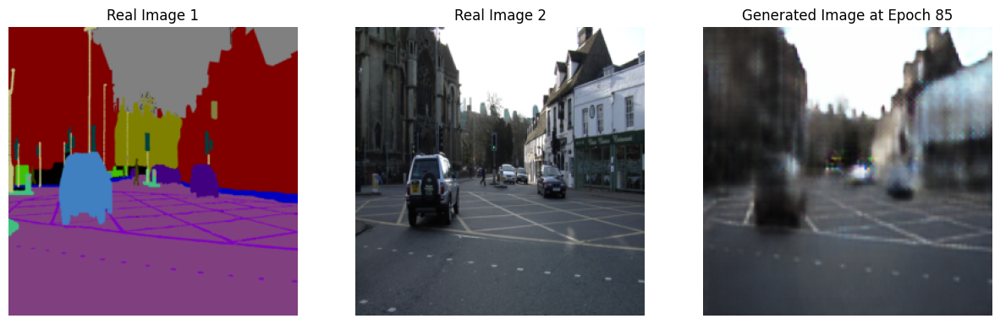

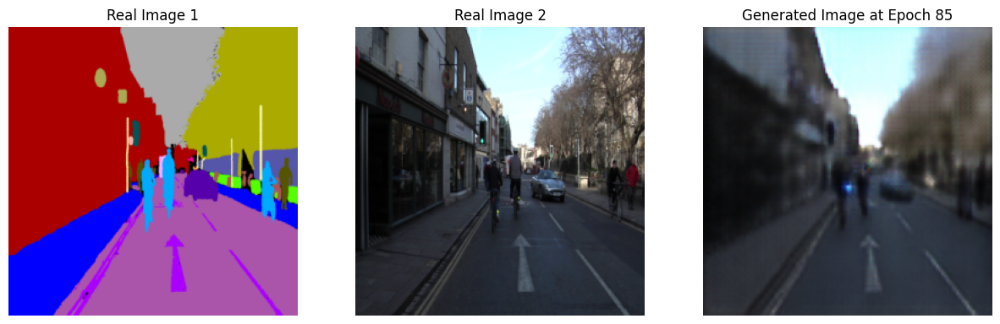

Epoch [86/100], d_loss: 1.5138, g_loss: 6.5370, val_loss: 9.1352
44.501503705978394
Epoch [87/100], d_loss: 1.7302, g_loss: 11.2489, val_loss: 14.4099
44.39240097999573
Epoch [88/100], d_loss: 1.7301, g_loss: 7.4797, val_loss: 9.9210
44.44725441932678
Epoch [89/100], d_loss: 1.5639, g_loss: 10.8349, val_loss: 11.5766
45.22394299507141
Epoch [90/100], d_loss: 1.2767, g_loss: 6.1972, val_loss: 9.1704
44.36941623687744


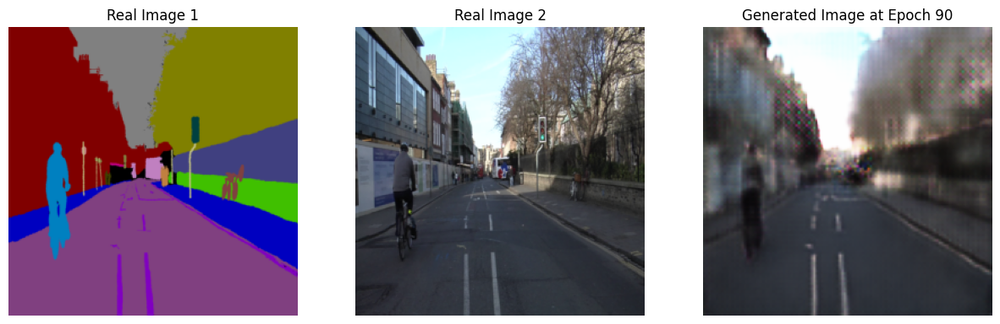

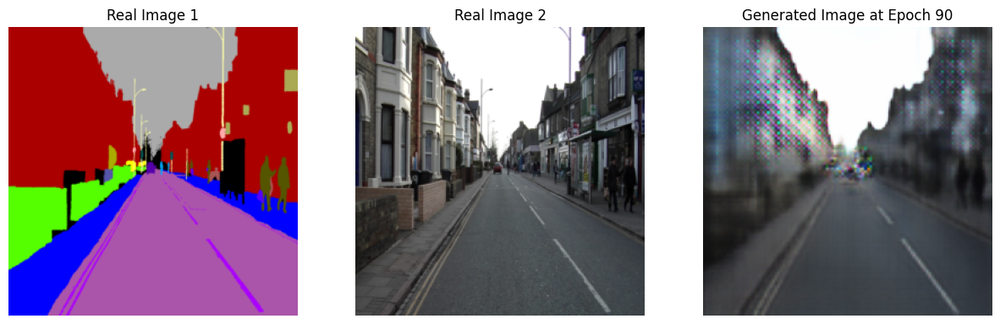

Epoch [91/100], d_loss: 1.5693, g_loss: 7.8431, val_loss: 9.0897
44.5247015953064
Epoch [92/100], d_loss: 1.4436, g_loss: 16.2299, val_loss: 8.7693
45.0151629447937
Epoch [93/100], d_loss: 1.3510, g_loss: 6.9089, val_loss: 9.4932
44.50305533409119
Epoch [94/100], d_loss: 1.6159, g_loss: 14.4796, val_loss: 8.7484
44.723392724990845
Epoch [95/100], d_loss: 1.5656, g_loss: 6.4363, val_loss: 8.5370
44.02379250526428


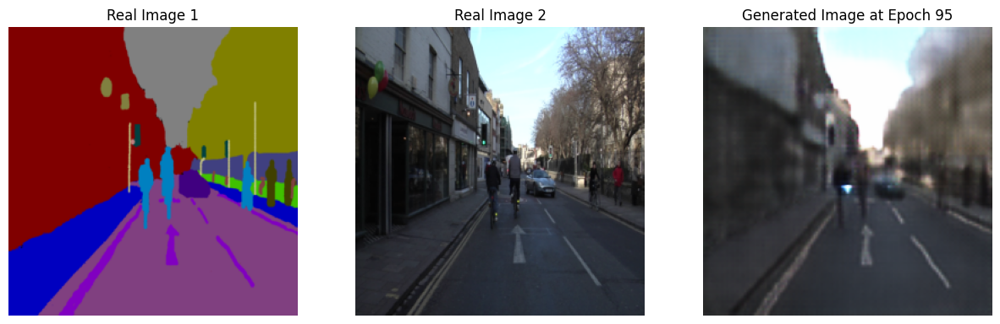

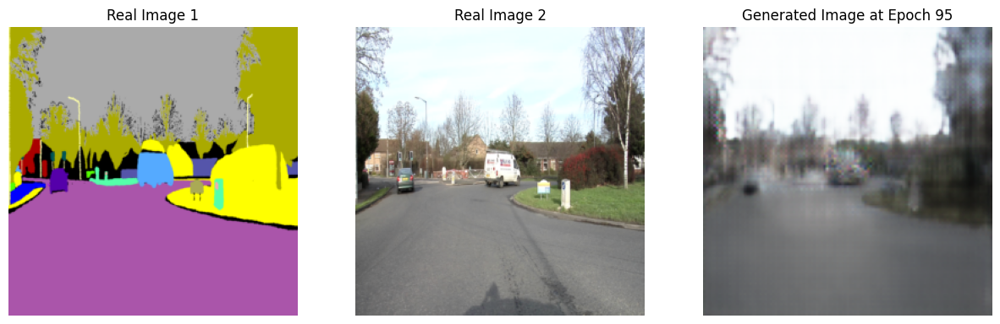

Epoch [96/100], d_loss: 1.4383, g_loss: 8.4390, val_loss: 8.8500
44.378182888031006
Epoch [97/100], d_loss: 1.5267, g_loss: 8.1377, val_loss: 8.9577
43.83802342414856
Epoch [98/100], d_loss: 1.1788, g_loss: 9.2960, val_loss: 11.1711
44.13861060142517
Epoch [99/100], d_loss: 1.6549, g_loss: 5.4587, val_loss: 8.6351
44.52413725852966
Epoch [100/100], d_loss: 1.3643, g_loss: 8.8683, val_loss: 10.4519
44.035768032073975


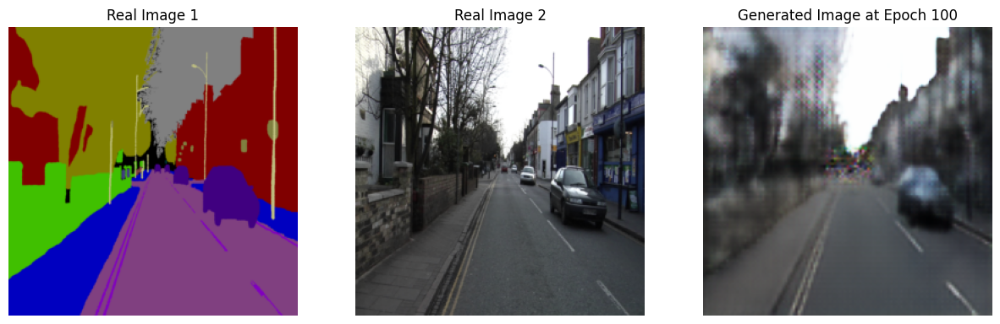

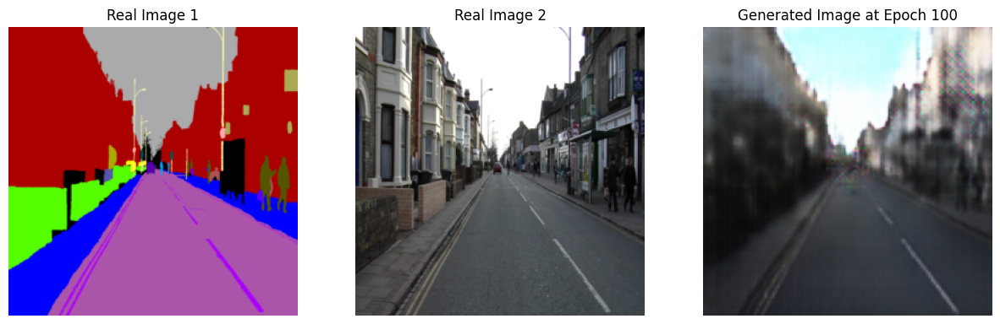

Treinamento concluído!


In [13]:
from matplotlib import pyplot as plt

# Instanciando o modelo GAN
gan = PaisagemGAN(generator=gene, discriminator=disc)
gan = gan.to(device)
gan.compile(g_loss=g_loss, d_loss=d_loss)

# Número de épocas
num_epochs = 100


# Loop de treinamento
print("Iniciar treinamento")
g_losses = []
d_losses = []
val_losses = []
for epoch in range(num_epochs):
    i = 0
    inicio = time.time()
    train_g_loss = 0.0
    train_d_loss = 0.0
    for batch in train_loader:
        real_images = normalize(batch[1].to(device))
        grey_images = normalize(batch[0].to(device))
        loss = gan.train_step(real_images, grey_images)
        i += 1
        train_g_loss += loss['g_loss']
        train_d_loss += loss['d_loss']
        real_images.cpu()
        grey_images.cpu()
    g_losses.append(train_g_loss/len(train_loader))
    d_losses.append(train_d_loss/len(train_loader))
    
    # Avaliação no conjunto de validação
    val_loss = 0.0
    with torch.no_grad():
        for val_batch in val_loader:
            val_real_images = normalize(val_batch[1].to(device))
            val_grey_images = normalize(val_batch[0].to(device))
            val_fake_images = gan.generator(val_grey_images)
            val_yhat_fake = gan.discriminator(val_fake_images)
            last_v_loss = g_loss(val_yhat_fake, val_fake_images, val_real_images)
            val_loss += last_v_loss.item()
            val_real_images.cpu()
            val_grey_images.cpu()
    
    val_loss /= len(val_loader)
    val_losses.append(val_loss)
    
    print(f"Epoch [{epoch+1}/{num_epochs}], d_loss: {loss['d_loss']:.4f}, g_loss: {loss['g_loss']:.4f}, val_loss: {val_loss:.4f}")
    fim = time.time()
    print(fim - inicio)

    if (epoch+1) % 5 == 0 or (epoch) == 0:
        save_checkpoint(gan.generator, gan.g_opt, epoch, batch, loss, filepath='/kaggle/working/gen.pth')
        save_checkpoint(gan.discriminator, gan.d_opt, epoch, batch, loss, filepath='/kaggle/working/disc.pth')

        # Desenhando evoluçao do treinamento
        # Convertendo as imagens geradas de 0-1 para 0-255
        gen_image = (loss['gen'][0].detach().cpu().numpy().transpose(1, 2, 0) * 255).astype('uint8')

        # Convertendo batch[0] e batch[1] de 0-1 para 0-255
        real_image1 = (batch[0][0].detach().cpu().numpy().transpose(1, 2, 0)*255).astype('uint8')
        real_image2 = (batch[1][0].detach().cpu().numpy().transpose(1, 2, 0)*255 ).astype('uint8')

        # Plotando as três imagens lado a lado
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(real_image1)
        axes[0].set_title("Real Image 1")

        axes[1].imshow(real_image2)
        axes[1].set_title("Real Image 2")

        axes[2].imshow(gen_image)
        axes[2].set_title(f"Generated Image at Epoch {epoch + 1}")

        for ax in axes:
            ax.axis('off')  # Remove os eixos

        plt.show()

        # Desenhando evolução da validação
        # Convertendo as imagens geradas de 0-1 para 0-255
        gen_image = (val_fake_images[0].detach().cpu().numpy().transpose(1, 2, 0) * 255).astype('uint8')

        # Convertendo batch[0] e batch[1] de 0-1 para 0-255
        real_image1 = (val_grey_images[0].detach().cpu().numpy().transpose(1, 2, 0) * 255).astype('uint8')
        real_image2 = (val_real_images[0].detach().cpu().numpy().transpose(1, 2, 0) * 255 ).astype('uint8')
        
        # Plotando as três imagens lado a lado
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(real_image1)
        axes[0].set_title("Real Image 1")

        axes[1].imshow(real_image2)
        axes[1].set_title("Real Image 2")

        axes[2].imshow(gen_image)
        axes[2].set_title(f"Generated Image at Epoch {epoch + 1}")

        for ax in axes:
            ax.axis('off')

        plt.show()
        

print("Treinamento concluído!")


In [14]:
#torch.cuda.empty_cache()
print(val_losses)

[14.421792575291224, 13.882772445678711, 12.927758761814662, 14.703701428004674, 13.002650669642858, 15.832406316484724, 11.998078210013253, 13.1874452318464, 11.965175356183734, 11.533273151942662, 11.649382591247559, 11.948492731366839, 11.876866068158831, 11.366551262991768, 12.748429298400879, 10.401986122131348, 11.012577874319893, 11.220194816589355, 12.059386253356934, 10.761537960597447, 9.759444645472936, 10.401951108660016, 10.549349239894322, 11.283851759774345, 9.764698028564453, 11.868177550179619, 9.675514357430595, 9.60884598323277, 10.478558267865862, 10.702597209385463, 11.59931755065918, 11.783974102565221, 10.657591956002372, 9.320099694388253, 10.025352341788155, 10.139337812151227, 9.733992440359932, 11.677500588553292, 9.478580338614327, 9.210521561758858, 9.015192576817103, 10.9731080191476, 8.76455579485212, 8.843480518886022, 9.123933792114258, 8.974720750536237, 10.10081945146833, 10.537938117980957, 9.378215789794922, 10.966850417000908, 9.345004490443639, 10

In [15]:
import csv

# Caminho do arquivo onde as perdas serão salvas
loss_file_path = '/kaggle/working/losses.csv'

# Função para salvar as perdas em um arquivo CSV
def save_losses_to_csv(g_losses, d_losses, val_losses, file_path):
    with open(file_path, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['Epoch', 'G Loss', 'D Loss', 'Validation Loss'])
        for epoch, (g, d, val_loss) in enumerate(zip(g_losses, d_losses, val_losses), start=1):
            writer.writerow([epoch, g, d, val_loss])

# Salvar as perdas
save_losses_to_csv(g_losses, d_losses, val_losses, loss_file_path)

print(f"Losses saved to {loss_file_path}")

Losses saved to /kaggle/working/losses.csv
